In [1]:
import datetime as dt
import pandas as pd
import numpy as np
import seaborn as sns

%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('ggplot') # optional: for ggplot-like style

import itertools
from matplotlib.ticker import NullFormatter
import matplotlib.ticker as ticker
from sklearn import preprocessing

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
!wget -O dftRoadSafetyData_Accidents_2018.csv http://data.dft.gov.uk/road-accidents-safety-data/dftRoadSafetyData_Accidents_2018.csv
!wget -O dftRoadSafetyData_Vehicles_2018.csv http://data.dft.gov.uk/road-accidents-safety-data/dftRoadSafetyData_Vehicles_2018.csv

--2020-09-24 09:00:49--  http://data.dft.gov.uk/road-accidents-safety-data/dftRoadSafetyData_Accidents_2018.csv
Resolving data.dft.gov.uk (data.dft.gov.uk)... 52.218.53.81
Connecting to data.dft.gov.uk (data.dft.gov.uk)|52.218.53.81|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 16827907 (16M) [application/octet-stream]
Saving to: ‘dftRoadSafetyData_Accidents_2018.csv’

dftRoadSafetyData_A 100%[===================>]  16.05M  5.11MB/s    in 3.1s    

2020-09-24 09:00:53 (5.11 MB/s) - ‘dftRoadSafetyData_Accidents_2018.csv’ saved [16827907/16827907]

--2020-09-24 09:00:53--  http://data.dft.gov.uk/road-accidents-safety-data/dftRoadSafetyData_Vehicles_2018.csv
Resolving data.dft.gov.uk (data.dft.gov.uk)... 52.218.30.82
Connecting to data.dft.gov.uk (data.dft.gov.uk)|52.218.30.82|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14803084 (14M) [application/octet-stream]
Saving to: ‘dftRoadSafetyData_Vehicles_2018.csv’

dftRoadSafetyData_V 100

In [3]:
df_acc = pd.read_csv('dftRoadSafetyData_Accidents_2018.csv', index_col='Accident_Index')
df_acc.head()

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,Day_of_Week,Time,Local_Authority_(District),Local_Authority_(Highway),1st_Road_Class,1st_Road_Number,Road_Type,Speed_limit,Junction_Detail,Junction_Control,2nd_Road_Class,2nd_Road_Number,Pedestrian_Crossing-Human_Control,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location
Accident_Index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018010080971,529150.0,182270.0,-0.139737,51.524587,1,3,2,2,01/01/2018,2,01:30,2,E09000007,3,501,3,30,0,-1,-1,0,0,0,4,1,1,0,0,1,1,E01000854
2018010080973,542020.0,184290.0,0.046471,51.539651,1,3,1,1,01/01/2018,2,00:50,17,E09000025,4,165,6,30,2,4,6,0,0,0,4,1,1,0,0,1,1,E01003531
2018010080974,531720.0,182910.0,-0.102474,51.529746,1,3,2,1,01/01/2018,2,00:45,3,E09000019,3,1,6,20,6,4,5,0,0,5,4,1,1,0,0,1,1,E01002723
2018010080981,541450.0,183220.0,0.037828,51.530179,1,2,2,1,01/01/2018,2,03:00,17,E09000025,4,167,3,30,7,2,3,124,0,5,4,2,2,0,0,1,1,E01003492
2018010080982,543580.0,176500.0,0.065781,51.469258,1,2,2,2,01/01/2018,2,02:20,6,E09000011,3,207,6,30,0,-1,-1,0,0,0,4,1,2,0,0,1,1,E01001682


In [4]:
df_acc.shape

(122635, 31)

In [5]:
df_veh = pd.read_csv('dftRoadSafetyData_Vehicles_2018.csv' , error_bad_lines=False, index_col='Accident_Index', warn_bad_lines=False)
df_veh.head()

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Vehicle_Reference,Vehicle_Type,Towing_and_Articulation,Vehicle_Manoeuvre,Vehicle_Location-Restricted_Lane,Junction_Location,Skidding_and_Overturning,Hit_Object_in_Carriageway,Vehicle_Leaving_Carriageway,Hit_Object_off_Carriageway,1st_Point_of_Impact,Was_Vehicle_Left_Hand_Drive?,Journey_Purpose_of_Driver,Sex_of_Driver,Age_of_Driver,Age_Band_of_Driver,Engine_Capacity_(CC),Propulsion_Code,Age_of_Vehicle,Driver_IMD_Decile,Driver_Home_Area_Type,Vehicle_IMD_Decile
Accident_Index,,,,,,,,,,,,,,,,,,,,,,
2018010080971,1,9,0,18,0,0,0,0,0,0,1,1,6,1,32,6,1995,2,5,8,1,8
2018010080971,2,8,0,18,0,0,0,0,0,0,2,1,6,1,48,8,1798,8,6,1,1,1
2018010080973,1,9,0,18,0,2,0,0,0,0,1,1,6,3,-1,-1,-1,-1,-1,-1,-1,-1
2018010080974,1,8,0,7,0,8,0,0,0,0,1,1,1,1,40,7,1797,8,6,3,1,3
2018010080974,2,9,0,18,0,1,0,0,3,1,1,1,6,1,21,5,-1,-1,-1,5,1,5


In [6]:
df_veh.shape

(226409, 22)

In [7]:
df_join = df_acc.join(df_veh, how='outer')
df_join.head()

,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,Day_of_Week,Time,Local_Authority_(District),Local_Authority_(Highway),1st_Road_Class,1st_Road_Number,Road_Type,Speed_limit,Junction_Detail,Junction_Control,2nd_Road_Class,2nd_Road_Number,Pedestrian_Crossing-Human_Control,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location,Vehicle_Reference,Vehicle_Type,Towing_and_Articulation,Vehicle_Manoeuvre,Vehicle_Location-Restricted_Lane,Junction_Location,Skidding_and_Overturning,Hit_Object_in_Carriageway,Vehicle_Leaving_Carriageway,Hit_Object_off_Carriageway,1st_Point_of_Impact,Was_Vehicle_Left_Hand_Drive?,Journey_Purpose_of_Driver,Sex_of_Driver,Age_of_Driver,Age_Band_of_Driver,Engine_Capacity_(CC),Propulsion_Code,Age_of_Vehicle,Driver_IMD_Decile,Driver_Home_Area_Type,Vehicle_IMD_Decile
Accident_Index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018010080971,529150.0,182270.0,-0.139737,51.524587,1.0,3.0,2.0,2.0,01/01/2018,2.0,01:30,2.0,E09000007,3.0,501.0,3.0,30.0,0.0,-1.0,-1.0,0.0,0.0,0.0,4.0,1.0,1.0,0.0,0.0,1.0,1.0,E01000854,1.0,9.0,0.0,18.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,6.0,1.0,32.0,6.0,1995.0,2.0,5.0,8.0,1.0,8.0
2018010080971,529150.0,182270.0,-0.139737,51.524587,1.0,3.0,2.0,2.0,01/01/2018,2.0,01:30,2.0,E09000007,3.0,501.0,3.0,30.0,0.0,-1.0,-1.0,0.0,0.0,0.0,4.0,1.0,1.0,0.0,0.0,1.0,1.0,E01000854,2.0,8.0,0.0,18.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,6.0,1.0,48.0,8.0,1798.0,8.0,6.0,1.0,1.0,1.0
2018010080973,542020.0,184290.0,0.046471,51.539651,1.0,3.0,1.0,1.0,01/01/2018,2.0,00:50,17.0,E09000025,4.0,165.0,6.0,30.0,2.0,4.0,6.0,0.0,0.0,0.0,4.0,1.0,1.0,0.0,0.0,1.0,1.0,E01003531,1.0,9.0,0.0,18.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,1.0,6.0,3.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2018010080974,531720.0,182910.0,-0.102474,51.529746,1.0,3.0,2.0,1.0,01/01/2018,2.0,00:45,3.0,E09000019,3.0,1.0,6.0,20.0,6.0,4.0,5.0,0.0,0.0,5.0,4.0,1.0,1.0,0.0,0.0,1.0,1.0,E01002723,1.0,8.0,0.0,7.0,0.0,8.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,40.0,7.0,1797.0,8.0,6.0,3.0,1.0,3.0
2018010080974,531720.0,182910.0,-0.102474,51.529746,1.0,3.0,2.0,1.0,01/01/2018,2.0,00:45,3.0,E09000019,3.0,1.0,6.0,20.0,6.0,4.0,5.0,0.0,0.0,5.0,4.0,1.0,1.0,0.0,0.0,1.0,1.0,E01002723,2.0,9.0,0.0,18.0,0.0,1.0,0.0,0.0,3.0,1.0,1.0,1.0,6.0,1.0,21.0,5.0,-1.0,-1.0,-1.0,5.0,1.0,5.0


In [8]:
df_join.shape

(228256, 53)

In [9]:
missing_data = df_join.isnull()
missing_data.head(5)

,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,Day_of_Week,Time,Local_Authority_(District),Local_Authority_(Highway),1st_Road_Class,1st_Road_Number,Road_Type,Speed_limit,Junction_Detail,Junction_Control,2nd_Road_Class,2nd_Road_Number,Pedestrian_Crossing-Human_Control,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location,Vehicle_Reference,Vehicle_Type,Towing_and_Articulation,Vehicle_Manoeuvre,Vehicle_Location-Restricted_Lane,Junction_Location,Skidding_and_Overturning,Hit_Object_in_Carriageway,Vehicle_Leaving_Carriageway,Hit_Object_off_Carriageway,1st_Point_of_Impact,Was_Vehicle_Left_Hand_Drive?,Journey_Purpose_of_Driver,Sex_of_Driver,Age_of_Driver,Age_Band_of_Driver,Engine_Capacity_(CC),Propulsion_Code,Age_of_Vehicle,Driver_IMD_Decile,Driver_Home_Area_Type,Vehicle_IMD_Decile
Accident_Index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2018010080971,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2018010080971,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2018010080973,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2018010080974,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2018010080974,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [10]:
for column in missing_data.columns.values.tolist():
    print(column)
    print (missing_data[column].value_counts())
    print("")  

Location_Easting_OSGR
False    224815
True       3441
Name: Location_Easting_OSGR, dtype: int64

Location_Northing_OSGR
False    224815
True       3441
Name: Location_Northing_OSGR, dtype: int64

Longitude
False    224815
True       3441
Name: Longitude, dtype: int64

Latitude
False    224815
True       3441
Name: Latitude, dtype: int64

Police_Force
False    224911
True       3345
Name: Police_Force, dtype: int64

Accident_Severity
False    224911
True       3345
Name: Accident_Severity, dtype: int64

Number_of_Vehicles
False    224911
True       3345
Name: Number_of_Vehicles, dtype: int64

Number_of_Casualties
False    224911
True       3345
Name: Number_of_Casualties, dtype: int64

Date
False    224911
True       3345
Name: Date, dtype: int64

Day_of_Week
False    224911
True       3345
Name: Day_of_Week, dtype: int64

Time
False    224889
True       3367
Name: Time, dtype: int64

Local_Authority_(District)
False    224911
True       3345
Name: Local_Authority_(District), dtype: int

In [11]:
for col in df_join.columns:
    df_join = (df_join[df_join[col]!=-1])

    df_join['Time'] = pd.to_datetime(df_join.Time)
df_join.dropna(inplace=True)

In [12]:
df_join.shape

(70383, 53)

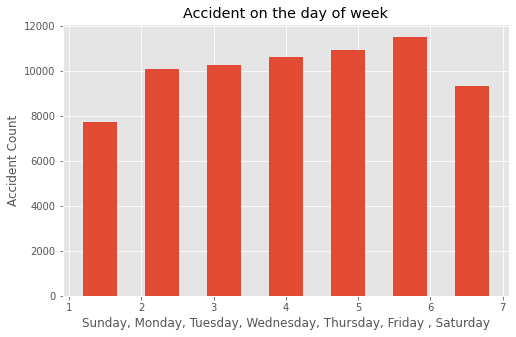

In [13]:
df_join['Day_of_Week'].plot(kind='hist', bins=7, rwidth=0.55, figsize=(8, 5))

plt.title('Accident on the day of week') # add a title to the histogram
plt.ylabel('Accident Count') # add y-label
plt.xlabel('Sunday, Monday, Tuesday, Wednesday, Thursday, Friday , Saturday') # add x-label

plt.show()

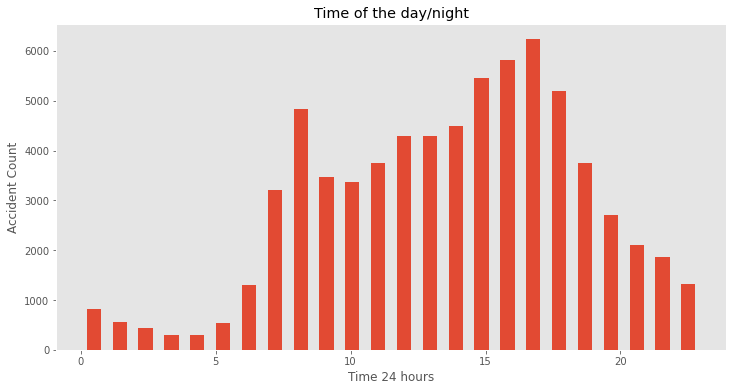

In [14]:
df_join.Time.dt.hour.hist(bins=24, rwidth=0.55, figsize=(12, 6))
plt.grid(False)
plt.title('Time of the day/night') # add a title to the histogram
plt.ylabel('Accident Count') # add y-label
plt.xlabel('Time 24 hours') # add x-label

plt.show()

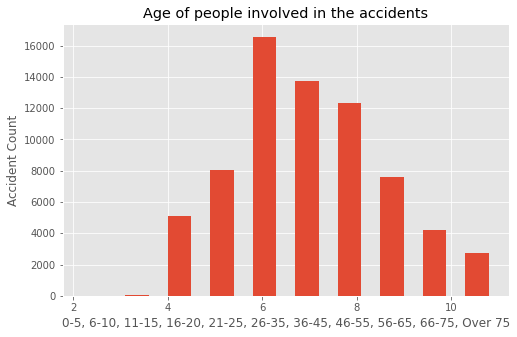

In [15]:
df_join['Age_Band_of_Driver'].plot(kind='hist', bins=10, rwidth=0.55, figsize=(8, 5))

plt.title('Age of people involved in the accidents') # add a title to the histogram
plt.ylabel('Accident Count') # add y-label
plt.xlabel('0-5, 6-10, 11-15, 16-20, 21-25, 26-35, 36-45, 46-55, 56-65, 66-75, Over 75') # add x-label

plt.show()

In [16]:
df_join['Engine_Capacity_(CC)'].value_counts()

1598.0     5526
1968.0     2719
998.0      2662
1995.0     2554
1560.0     2295
           ... 
1297.0        1
454.0         1
5999.0        1
987.0         1
10667.0       1
Name: Engine_Capacity_(CC), Length: 866, dtype: int64

In [17]:
df_spd = df_join['Speed_limit'].value_counts()

In [18]:
df_spd

30.0    45875
40.0     7246
60.0     6967
20.0     5051
50.0     2945
70.0     2299
Name: Speed_limit, dtype: int64

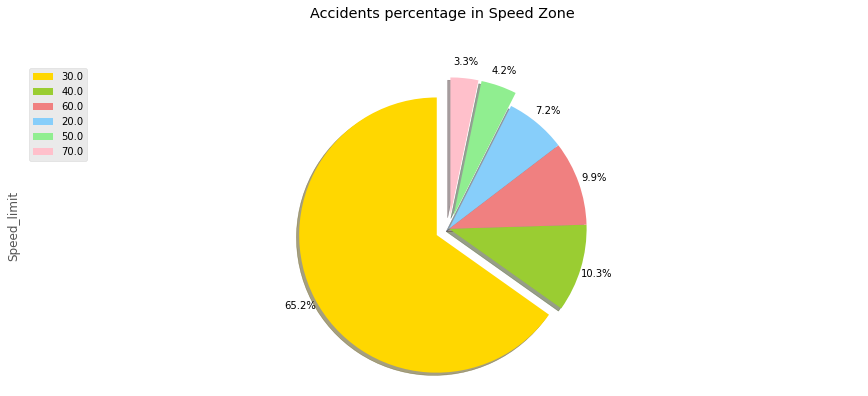

In [19]:
colors_list = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'lightgreen', 'pink']
explode_list = [0.1, 0, 0, 0, 0.1, 0.1] # ratio for each continent with which to offset each wedge.

df_spd.plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=True,       
                            labels=None,         # turn off labels on pie chart
                            pctdistance=1.12,    # the ratio between the center of each pie slice and the start of the text generated by autopct 
                            colors=colors_list,  # add custom colors
                            explode=explode_list # 'explode' lowest 3 continents
                            )

# scale the title up by 12% to match pctdistance
plt.title('Accidents percentage in Speed Zone', y=1.12) 

plt.axis('equal') 

# add legend
plt.legend(labels=df_spd.index, loc='upper left') 

plt.show()

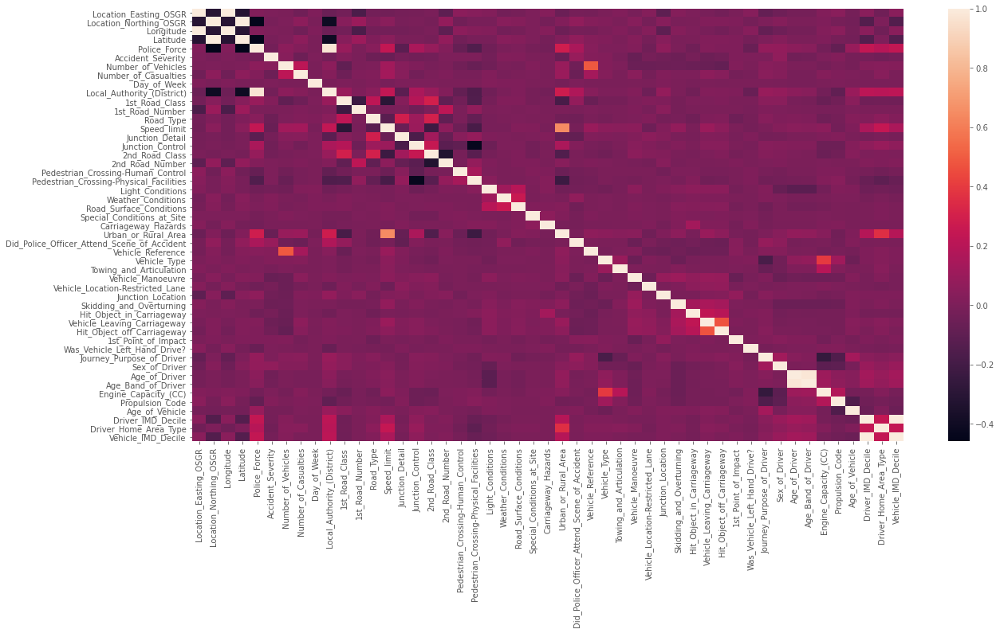

In [20]:
corr =  df_join.corr()
plt.subplots(figsize=(20,10))
sns.heatmap(corr)

In [21]:
!conda install -c conda-forge folium=0.5.0 --yes
import folium
from folium import plugins

/bin/bash: conda: command not found


In [22]:
# United Kingdom latitude and longitude values
latitude = 51.509865
longitude = -0.118092

# create map
uk_map = folium.Map(location = [latitude, longitude], zoom_start = 7)

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(uk_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label, in zip(df_join.Latitude, df_join.Longitude, df_join.Accident_Severity):
    folium.Marker(
        location=[lat, lng],
        icon=None,
    ).add_to(incidents)

# display map
uk_map

In [23]:
Feature = df_join[['Day_of_Week', 'Speed_limit', 'Light_Conditions', 'Weather_Conditions', 'Road_Surface_Conditions', 'Did_Police_Officer_Attend_Scene_of_Accident','Vehicle_Type', 'Sex_of_Driver', 'Age_of_Driver','Engine_Capacity_(CC)', 'Age_of_Vehicle']]
Feature.head()

,Day_of_Week,Speed_limit,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Did_Police_Officer_Attend_Scene_of_Accident,Vehicle_Type,Sex_of_Driver,Age_of_Driver,Engine_Capacity_(CC),Age_of_Vehicle
Accident_Index,,,,,,,,,,,
2018010080974,2.0,20.0,4.0,1.0,1.0,1.0,8.0,1.0,40.0,1797.0,6.0
2018010080981,2.0,30.0,4.0,2.0,2.0,1.0,9.0,1.0,27.0,1200.0,1.0
2018010080986,2.0,30.0,4.0,1.0,1.0,1.0,8.0,1.0,66.0,2499.0,5.0
2018010080987,2.0,30.0,7.0,1.0,1.0,1.0,8.0,2.0,36.0,1798.0,2.0
2018010080990,2.0,30.0,4.0,1.0,1.0,1.0,9.0,1.0,24.0,998.0,9.0


In [24]:
def category(Accident_Severity):
    if Accident_Severity == 1:
        return 'Fatal'
    elif Accident_Severity == 2:
        return 'Serious'
    elif Accident_Severity == 3:
        return 'Slight'
    else:
        return 'Unknown'

In [25]:
df_join['Accident_Severity'] = df_join['Accident_Severity'].apply(category)

In [26]:
y = df_join['Accident_Severity'].values
y[0:5]

array(['Slight', 'Serious', 'Serious', 'Slight', 'Slight'], dtype=object)

Normalize the dataset

In [27]:
X = Feature
X = preprocessing.StandardScaler().fit(X).transform(X)
X[0:5]

array([[-1.1028877 , -1.27600493,  1.37610048, -0.31278475, -0.53103063,
        -0.47545346, -0.26886736, -0.71842545, -0.10148738,  0.01207123,
        -0.4005003 ],
       [-1.1028877 , -0.44876728,  1.37610048,  0.34875528,  1.44483788,
        -0.47545346, -0.06259436, -0.71842545, -0.88281821, -0.40832768,
        -1.3400577 ],
       [-1.1028877 , -0.44876728,  1.37610048, -0.31278475, -0.53103063,
        -0.47545346, -0.26886736, -0.71842545,  1.46117427,  0.50640964,
        -0.58841178],
       [-1.1028877 , -0.44876728,  3.32989353, -0.31278475, -0.53103063,
        -0.47545346, -0.26886736,  1.37120752, -0.34189687,  0.01277541,
        -1.15214622],
       [-1.1028877 , -0.44876728,  1.37610048, -0.31278475, -0.53103063,
        -0.47545346, -0.06259436, -0.71842545, -1.06312532, -0.5505732 ,
         0.16323413]])

#K Nearest Neighbor(KNN)

In [28]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

Train set: (56306, 11) (56306,)
Test set: (14077, 11) (14077,)


In [29]:
from sklearn.neighbors import KNeighborsClassifier

k = 4
#Train Model and Predict  
knn_model = KNeighborsClassifier(n_neighbors=k).fit(X_train,y_train)
knn_model

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=4, p=2,
                     weights='uniform')

In [30]:
yhat = knn_model.predict(X_test)
yhat[0:5]

array(['Serious', 'Slight', 'Slight', 'Slight', 'Slight'], dtype=object)

In [31]:
Ks = 15
mean_acc=np.zeros((Ks-1))
std_acc=np.zeros((Ks-1))
ConfustionMx=[];
for n in range(1,Ks):
    
    #Train Model and Predict  
    knn_model = KNeighborsClassifier(n_neighbors=n).fit(X_train,y_train)
    yhat = knn_model.predict(X_test)
    
    
    mean_acc[n-1]=np.mean(yhat==y_test);
    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])
mean_acc

array([0.71059175, 0.6236414 , 0.76202316, 0.73360801, 0.78674433,
       0.7726078 , 0.79853662, 0.79093557, 0.80535625, 0.80180436,
       0.80812673, 0.80784258, 0.80997372, 0.8091923 ])

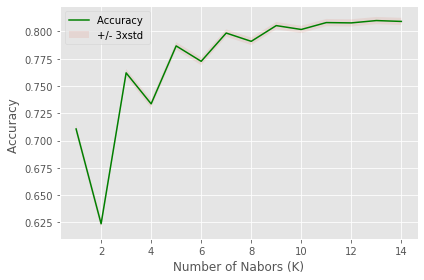

In [32]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Nabors (K)')
plt.tight_layout()
plt.show()

In [33]:
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1) 

The best accuracy was with 0.809973715990623 with k= 13


#Decision Tree

In [34]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

Train set: (56306, 11) (56306,)
Test set: (14077, 11) (14077,)


In [35]:
from sklearn.tree import DecisionTreeClassifier
Tree = DecisionTreeClassifier(criterion="entropy", max_depth = 4)
Tree.fit(X_train, y_train)
Tree # it shows the default parameters

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=4, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [36]:
from sklearn import metrics
yhat = Tree.predict(X_test)
print("DecisionTrees's Accuracy: ", metrics.accuracy_score(y_test, yhat))

DecisionTrees's Accuracy:  0.8148753285501172


In [37]:
from sklearn.externals.six import StringIO
import pydotplus
import matplotlib.image as mpimg
from sklearn import tree
%matplotlib inline 

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)


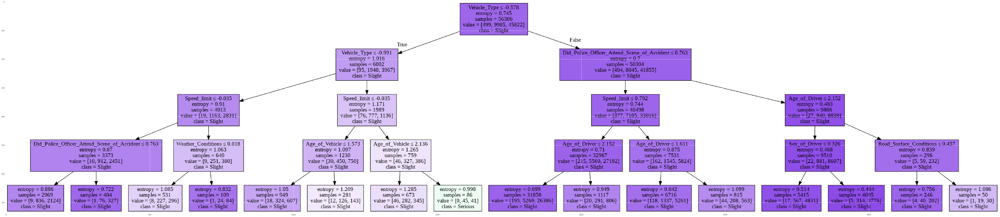

In [38]:
dot_data = StringIO()
filename = "Tree.png"
featureNames = Feature.columns[0:11]
targetNames = df_join["Accident_Severity"].unique().tolist()
out = tree.export_graphviz(Tree, feature_names = featureNames, out_file = dot_data, class_names= np.unique(y_train), filled = True, special_characters = True, rotate = False)  
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(filename)
img = mpimg.imread(filename)
plt.figure(figsize=(100, 200))
plt.imshow(img,interpolation='nearest')

#Feature importance

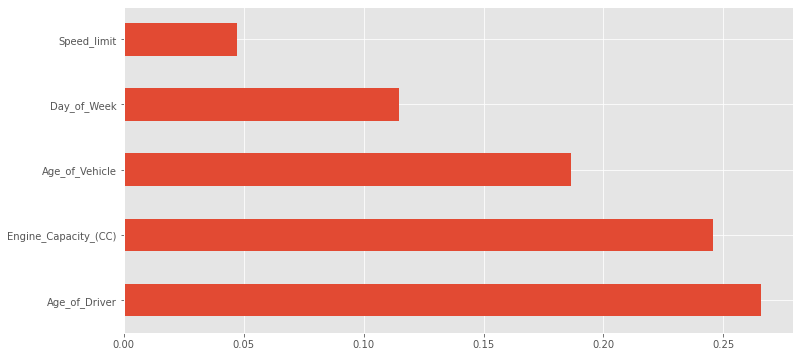

In [39]:
from sklearn.ensemble import RandomForestClassifier
random_forest = RandomForestClassifier(n_estimators=200)
random_forest.fit(X_train,y_train)
plt.figure(figsize = (12,6))
feat_importances = pd.Series(random_forest.feature_importances_, index = Feature.columns)
feat_importances.nlargest(5).plot(kind='barh')